## Get prediction

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt

import sys
import numpy as np
import torch

sys.path.insert(0, '..')
from isegm.ritm.utils import vis, exp

from isegm.inference import utils
from isegm.ritm.inference.predictors import get_predictor
from isegm.ritm.model.is_explainable_ritm_hrnet_model import RitmHRNetModelExplainable
from isegm.data.preprocess import Preprocessor

from tqdm.notebook import tqdm

device = torch.device('cuda:0')
cfg = exp.load_config_file('config.yml', return_edict=True)

In [ ]:
EVAL_MAX_CLICKS = 20
MODEL_THRESH = 0.49
TRAINING_OUTPUT_PATH = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training'
PRETRAINDED_WEIGHTS_PATH = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/weights'

# checkpoint_path = utils.find_checkpoint(PRETRAINDED_WEIGHTS_PATH, 'No clicks unlocked backbone a075')
checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'RITM-no clicks unlocked backbone')
print(checkpoint_path)

saved_model = utils.load_is_model(checkpoint_path, 'cpu', model_type='RITM')

# saved_model = utils.load_is_model(checkpoint_path, 'cpu', train_config=train_config)
saved_model = saved_model.to('cpu')
model = RitmHRNetModelExplainable(
        pipeline_version='s2',
        width=32,
        ocr_width=128,
        small=False,
        with_aux_output=True,
        use_leaky_relu=True,
        use_rgb_conv=False,
        use_disks=True,
        norm_radius=5,
        with_prev_mask=True,
        dynamic_radius_points=True
    )
model.load_state_dict(saved_model.state_dict())
model = model.to(device)
model.eval()

# Possible choices: 'NoBRS', 'f-BRS-A', 'f-BRS-B', 'f-BRS-C', 'RGB-BRS', 'DistMap-BRS'
# brs_mode = 'NoBRS'
brs_mode = 'NoBRSExplainable'

zoom_in_params = dict()
# zoom_in_params['skip_clicks'] = 0

/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/2024-02-03/23-55-27-RITM-no clicks unlocked backbone/checkpoints/best_model.pth
Model args: {'width': 32, 'ocr_width': 128, 'with_aux_output': True, 'use_leaky_relu': True, 'use_rgb_conv': False, 'use_disks': True, 'norm_radius': 5, 'with_prev_mask': True, 'model_type': 'RITM'}


In [3]:
# Possible choices: 'DAVIS', 'BRATS', 'LIDC', 'LIDC_2D_VAL', 'LIDC_2D_256_VAL', 'LIDC_CROPS_BOXED', 'LIDC_CROPS_WHITENED', 'LIDC_CROPS'
DATASET = 'LIDC_2D_VAL'
preprocessor = Preprocessor()
preprocessor.normalize = True
preprocessor.windowing = True
preprocessor.window_min = -900
preprocessor.window_max = 600
# preprocessor.convert_to_rgb = True

dataset = utils.get_dataset(DATASET, cfg, preprocessor=preprocessor)

In [4]:
list_shape = (len(dataset), 512, 512)
inputs = np.empty(list_shape)
gt_masks = np.empty(list_shape)
preds = np.empty(list_shape)
ious = np.empty(len(dataset))
for i in tqdm(range(len(dataset))):
    sample = dataset.get_sample(i)

    gt_mask = sample.gt_mask
    image = sample.image
    inputs[i] = image[:, :, 0]
    gt_masks[i] = gt_mask
    
    image = torch.permute(torch.from_numpy(image), (2, 0, 1))
    
    image = torch.cat((image, torch.zeros((1,512,512))), dim=0)
    
    image = torch.unsqueeze(image, 0).to(device)
    points = torch.full((1,2,4), -1).to(device)
    
    output, _ = model(image, points)
    
    pred = torch.squeeze(output['instances'], 0).detach().cpu().numpy()
    preds[i] = pred
    pred_mask = pred > 0.5
    iou = utils.get_iou(gt_mask, pred_mask)
    ious[i] = iou

  0%|          | 0/88 [00:00<?, ?it/s]

In [5]:
ious_flattened = ious.flatten()

In [46]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_zoomed_sample_by_index(index, title_prefix, expansion_factor=5):
    fig, ax = plt.subplots(figsize=(10, 5))  # Adjust subplot size as needed

    input_image = inputs[index]
    gt_mask = gt_masks[index]
    pred_mask = preds[index] > 0.5  # Assuming preds have been thresholded

    # Find the bounding box from the ground truth mask
    rows = np.any(gt_mask, axis=1)
    cols = np.any(gt_mask, axis=0)
    rmin, rmax = np.where(rows)[0][[0, -1]]
    cmin, cmax = np.where(cols)[0][[0, -1]]
    
    print(rmin, rmax, cmin, cmax)

    # Calculate center of the bounding box
    center_row, center_col = (rmax + rmin) // 2, (cmax + cmin) // 2

    # Expand the bounding box
    height = (rmax - rmin) * expansion_factor
    width = (cmax - cmin) * expansion_factor
    rmin = max(0, center_row - height // 2)
    rmax = min(input_image.shape[0], center_row + height // 2)
    cmin = max(0, center_col - width // 2)
    cmax = min(input_image.shape[1], center_col + width // 2)

    # Crop the image and masks to the expanded bounding box
    cropped_input_image = input_image[int(rmin):int(rmax), int(cmin):int(cmax)]
    cropped_gt_mask = gt_mask[int(rmin):int(rmax), int(cmin):int(cmax)]
    cropped_pred_mask = pred_mask[int(rmin):int(rmax), int(cmin):int(cmax)]

    # Show the cropped input image
    ax.imshow(cropped_input_image, cmap='gray')

    # Overlay the GT and prediction masks on the cropped image
    ax.contour(cropped_gt_mask, colors='w', levels=[0.5], linestyles='solid', linewidths=1.5)
    # ax.contour(cropped_pred_mask, colors='r', levels=[0.5], linestyles='dashed', linewidths=1.5)
    prediction_masked = np.ma.masked_where(cropped_pred_mask == 0, cropped_pred_mask)
    ax.imshow(prediction_masked, alpha=0.95, cmap='gist_rainbow')
    ax.set_title(f'{title_prefix} Sample {index}, IoU: {ious_flattened[index]:0.3f}')
    ax.axis('off')

    plt.tight_layout()
    plt.show()


350 380 222 266


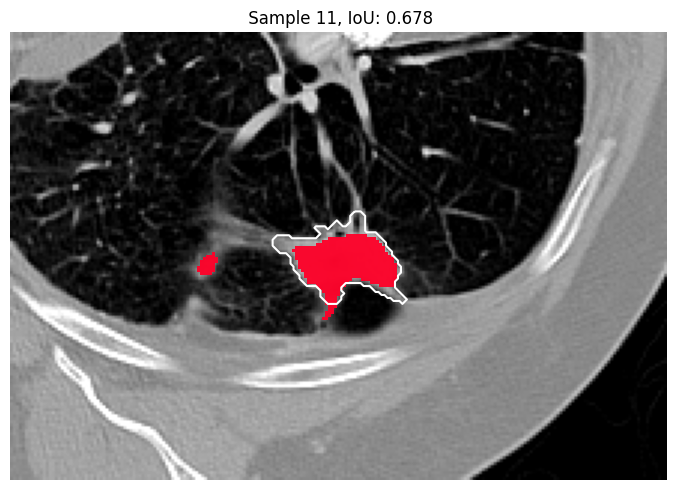

In [47]:
visualize_zoomed_sample_by_index(11, title_prefix='')

# Best and worst samples, OLD DATASET

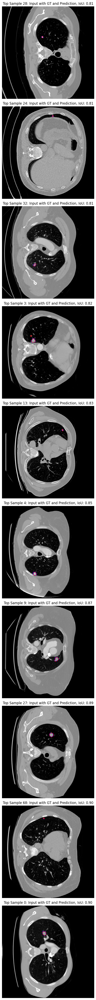

/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/ipykernel_launcher.py:15: UserWarning: No contour levels were found within the data range.
  from ipykernel import kernelapp as app


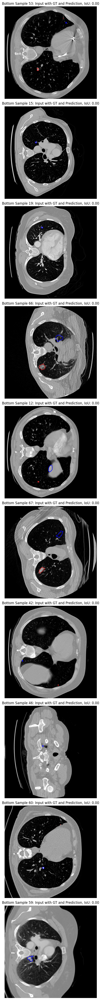

In [41]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_samples_with_overlays(indices, title_prefix):
    fig, axs = plt.subplots(len(indices), 1, figsize=(10, 5*len(indices)))  # Adjust subplot size as needed
    if len(indices) == 1:  # Ensure axs is iterable for a single sample
        axs = [axs]
    for i, idx in enumerate(indices):
        input_image = inputs[idx]
        gt_mask = gt_masks[idx]
        pred_mask = preds[idx] > 0.5  # Assuming preds have been thresholded

        axs[i].imshow(input_image, cmap='gray')  # Show the input image
        axs[i].contour(gt_mask, colors='b', levels=[0.5], linestyles='solid', linewidths=1.5)
        axs[i].contour(pred_mask, colors='r', levels=[0.5], linestyles='dashed', linewidths=1.5)
        axs[i].set_title(f'{title_prefix} Sample {idx}: Input with GT and Prediction, IoU: {ious_flattened[idx]:.2f}')
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()

# Assuming 'ious' is a 1D array of IoU scores for each sample
# Flatten the ious array if it's not already 1D
ious_flattened = ious.flatten()

# Get indices of the top 10 and bottom 10 IoU scores
top_10_indices = np.argsort(ious_flattened)[-10:]
bottom_10_indices = np.argsort(ious_flattened)[:10]

# Visualize the top 10 samples
visualize_samples_with_overlays(top_10_indices, "Top")

# Visualize the bottom 10 samples
visualize_samples_with_overlays(bottom_10_indices, "Bottom")


# Histogram with sampling OLD DATASET

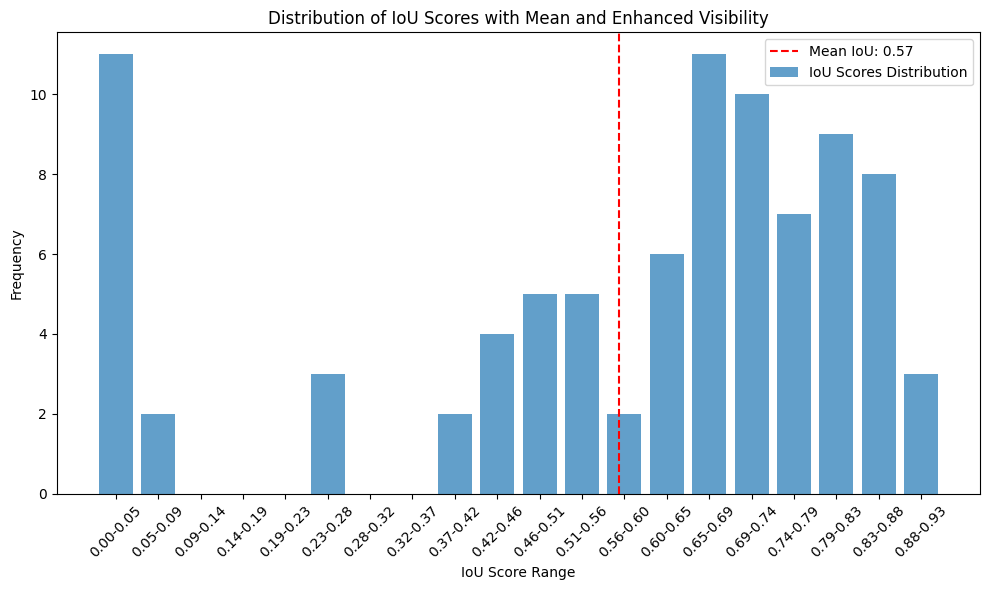

In [7]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'ious_flattened' is your 1D array of IoU scores
# Calculate the mean of the IoU scores
mean_iou = np.mean(ious_flattened)

# Number of bins for the histogram
n_bins = 20

# Create the bins for the histogram
# np.histogram_bin_edges can be used to get the exact bin edges used in the histogram
bin_edges = np.histogram_bin_edges(ious_flattened, bins=n_bins)

# Plotting the histogram of IoU scores with adjustments
plt.figure(figsize=(10, 6))  # Set the figure size as desired
histogram = plt.hist(ious_flattened, bins=bin_edges, alpha=0.7, label='IoU Scores Distribution', rwidth=0.8)

# Adding a vertical line for the mean IoU score
plt.axvline(mean_iou, color='r', linestyle='dashed', linewidth=1.5, label=f'Mean IoU: {mean_iou:.2f}')

# Generating tick marks and labels for each bin
# Setting ticks at the center of each bin for clarity
bin_centers = 0.5 * (bin_edges[1:] + bin_edges[:-1])
tick_labels = [f'{bin_edges[i]:.2f}-{bin_edges[i+1]:.2f}' for i in range(len(bin_edges)-1)]

plt.xticks(bin_centers, labels=tick_labels, rotation=45)  # Rotate the labels for better visibility

# Adding labels and title for clarity
plt.xlabel('IoU Score Range')
plt.ylabel('Frequency')
plt.title('Distribution of IoU Scores with Mean and Enhanced Visibility')
plt.legend()

# Show the plot with improvements
plt.tight_layout()
plt.show()


/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/ipykernel_launcher.py:33: UserWarning: No contour levels were found within the data range.


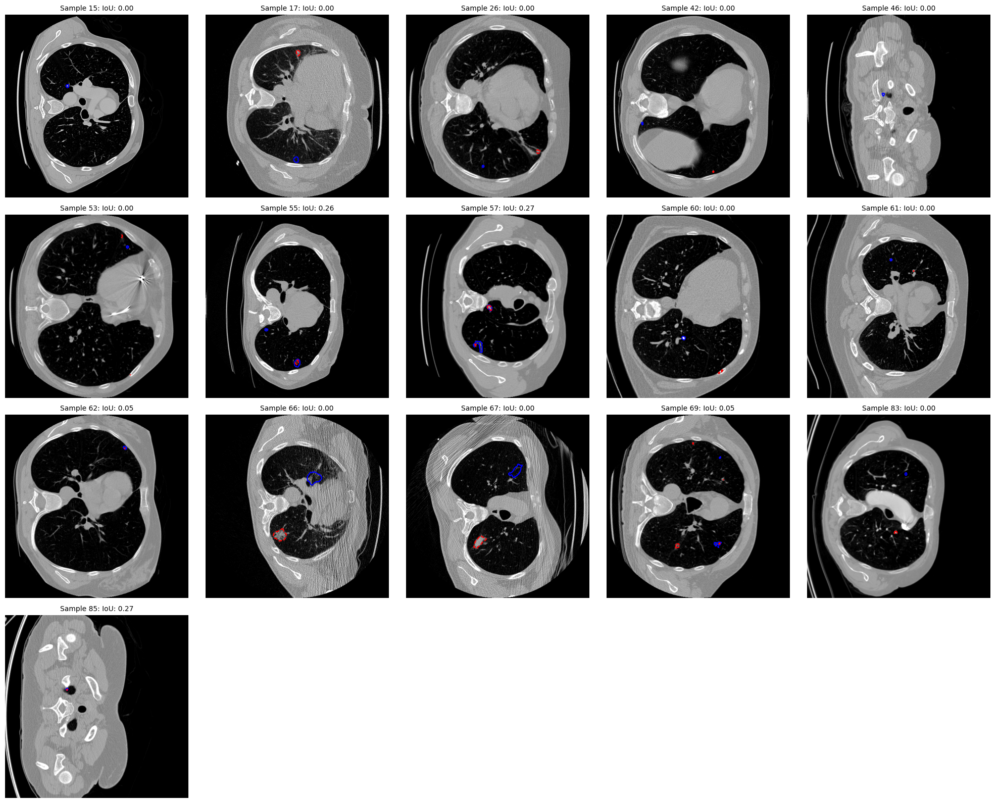

In [9]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_samples_in_range(iou_range, inputs, gt_masks, preds, ious_flattened):
    """
    Visualizes samples that fall within the specified IoU range.

    Parameters:
    - iou_range: A tuple (min_iou, max_iou) specifying the range of IoU scores.
    - inputs: Array of input images.
    - gt_masks: Array of ground truth masks.
    - preds: Array of predicted masks (before thresholding).
    - ious_flattened: 1D array of IoU scores for each sample.
    """
    # Filter indices by IoU range
    indices_in_range = [i for i, iou in enumerate(ious_flattened) if iou_range[0] <= iou <= iou_range[1]]
    
    # Calculate the number of rows needed for the subplot grid
    n_items = len(indices_in_range)
    n_rows = np.ceil(n_items / 5).astype(int)  # 5 items per row
    
    fig, axs = plt.subplots(n_rows, 5, figsize=(20, 4*n_rows), squeeze=False)  # Adjust subplot size as needed
    
    # Iterate over filtered indices to plot each sample
    for i, idx in enumerate(indices_in_range):
        row, col = divmod(i, 5)  # Determine the subplot row and column
        input_image = inputs[idx]
        gt_mask = gt_masks[idx]
        pred_mask = preds[idx] > 0.5  # Assuming preds have been thresholded
        
        axs[row, col].imshow(input_image, cmap='gray')  # Show the input image
        axs[row, col].contour(gt_mask, colors='b', levels=[0.5], linestyles='solid', linewidths=1.5)
        axs[row, col].contour(pred_mask, colors='r', levels=[0.5], linestyles='dashed', linewidths=1.5)
        axs[row, col].set_title(f'Sample {idx}: IoU: {ious_flattened[idx]:.2f}', fontsize=10)
        axs[row, col].axis('off')
    
    # Hide any unused axes in the last row
    for j in range(i + 1, n_rows * 5):
        row, col = divmod(j, 5)
        axs[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()

iou_range = (0, 0.3)  # Define the IoU range you're interested in
visualize_samples_in_range(iou_range, inputs, gt_masks, preds, ious_flattened)


In [3]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_dataset_with_gt_contours(dataset):
    """
    Visualizes the entire dataset showing each sample's image with its ground truth mask as a contour,
    followed by the ground truth mask alone in separate figures. Each figure will contain
    four plots (two images and their GT masks) for two samples.

    Parameters:
    - dataset: The dataset object with a `get_sample` method to access samples.
    """
    n_samples = len(dataset)  # Assuming the dataset object supports len()

    for i in range(0, n_samples, 2):  # Process two samples at a time
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))  # Create a new figure for each pair of samples
        
        for j in range(2):
            index = i + j
            if index < n_samples:  # Check to prevent index out of range
                sample = dataset.get_sample(index)
                image = sample.image[:,:,0]
                gt_mask = sample.gt_mask
                
                # Display input image with GT mask as contour
                col = j * 2  # Column index for image and its GT mask
                axs[col].imshow(image, cmap='gray')  # Show the input image
                axs[col].contour(gt_mask, colors='r', levels=[0.5], linestyles='solid', linewidths=1.5)
                axs[col].set_title(f'Sample {index}', fontsize=10)
                axs[col].axis('off')
                
                # Display GT mask alone
                axs[col + 1].imshow(gt_mask, cmap='gray')  # Show the GT mask
                axs[col + 1].set_title(f'GT Mask {index}', fontsize=10)
                axs[col + 1].axis('off')
                
            else:  # Hide unused subplots if the total number of samples is odd
                axs[j * 2].axis('off')
                axs[j * 2 + 1].axis('off')
                
        plt.tight_layout()
        plt.show()

# Example usage:
# visualize_dataset_with_gt_contours(dataset)


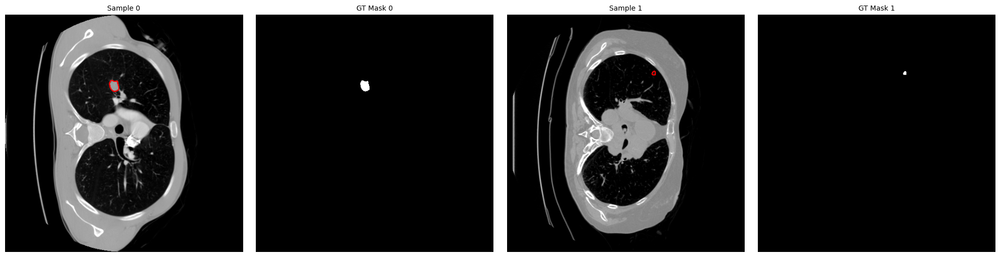

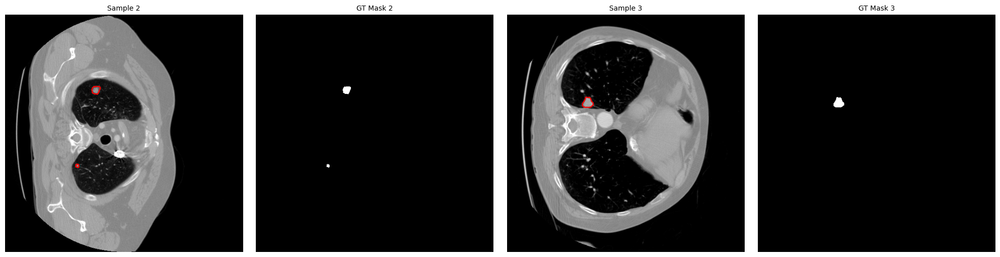

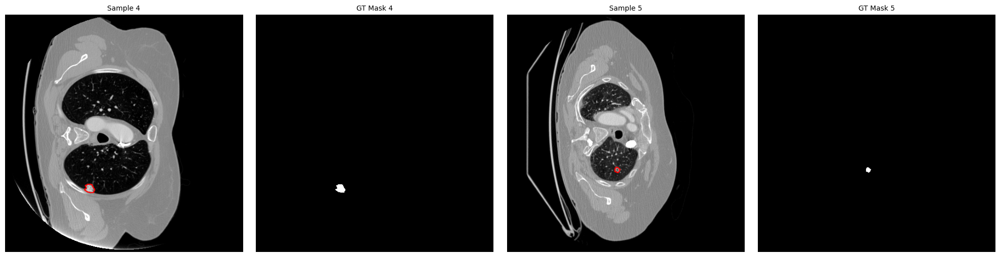

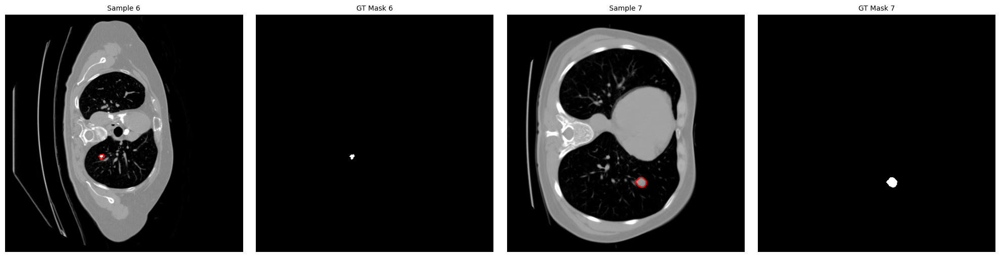

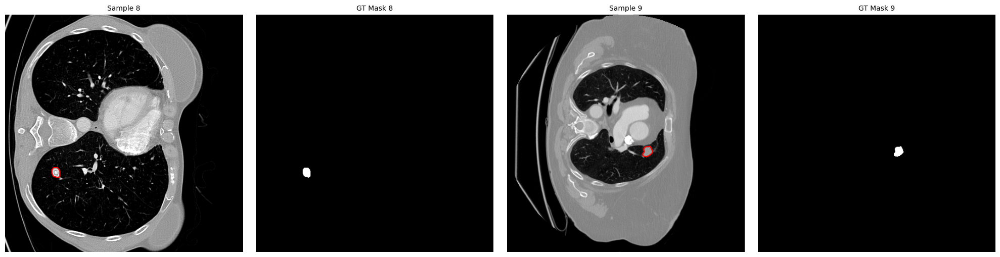

...

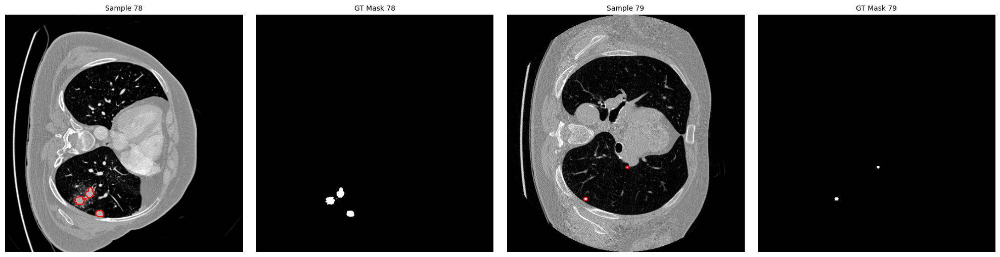

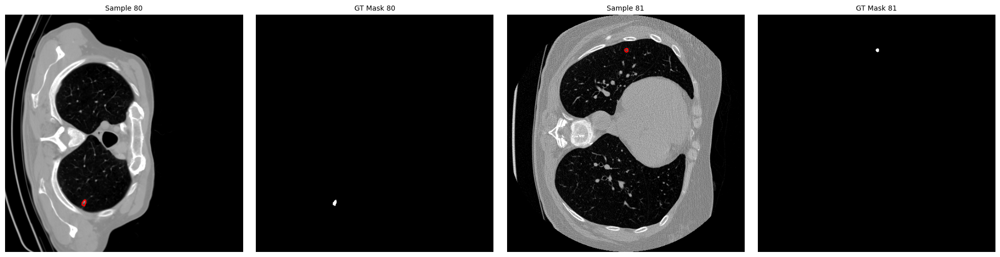

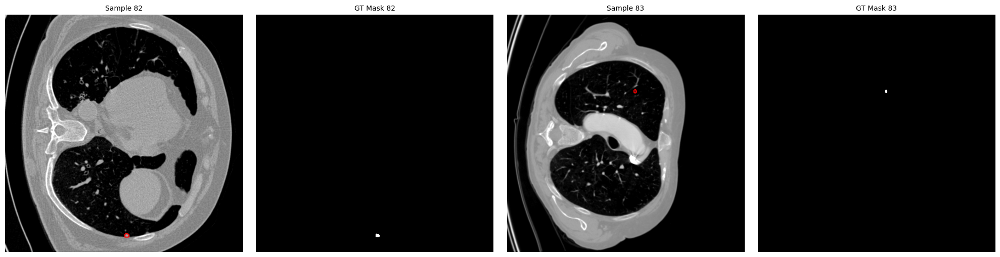

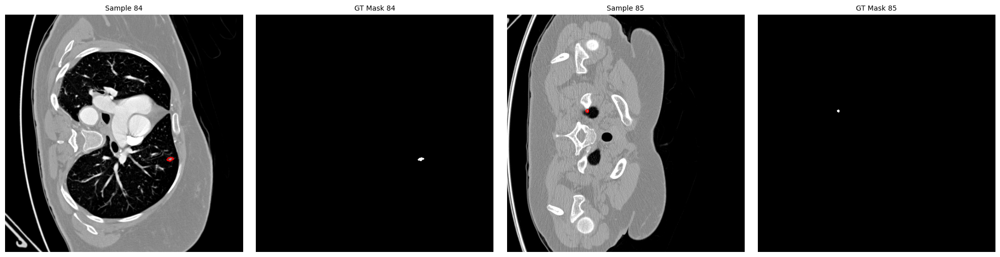

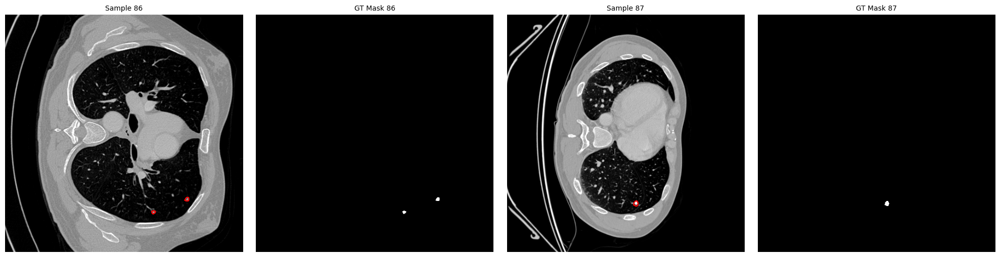

In [9]:
visualize_dataset_with_gt_contours(dataset)

In [4]:
dataset.get_sample_paths(17)

('/gpfs/space/projects/PerkinElmer/donatasv_experiments/datasets/processed_datasets/LIDC-2D/val/slices/lidc_0262.npy',
 '/gpfs/space/projects/PerkinElmer/donatasv_experiments/datasets/processed_datasets/LIDC-2D/val/slice_annotations/lidc_0262.npy')

In [4]:
dataset.get_sample_paths(66)

('/gpfs/space/projects/PerkinElmer/donatasv_experiments/datasets/processed_datasets/LIDC-2D/val/slices/lidc_0785.npy',
 '/gpfs/space/projects/PerkinElmer/donatasv_experiments/datasets/processed_datasets/LIDC-2D/val/slice_annotations/lidc_0785.npy')

In [5]:
dataset.get_sample_paths(67)

('/gpfs/space/projects/PerkinElmer/donatasv_experiments/datasets/processed_datasets/LIDC-2D/val/slices/lidc_0796.npy',
 '/gpfs/space/projects/PerkinElmer/donatasv_experiments/datasets/processed_datasets/LIDC-2D/val/slice_annotations/lidc_0796.npy')

# NEW DATASET

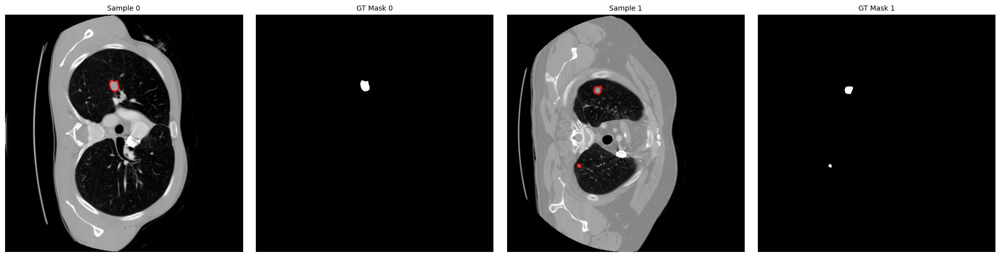

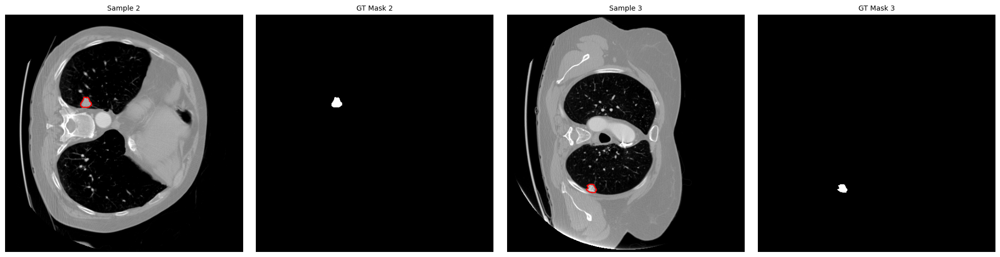

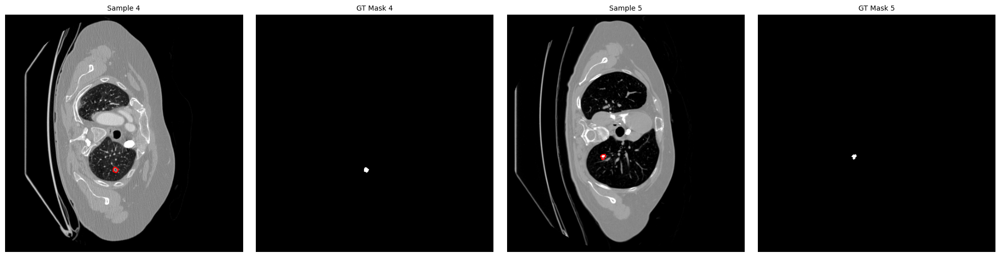

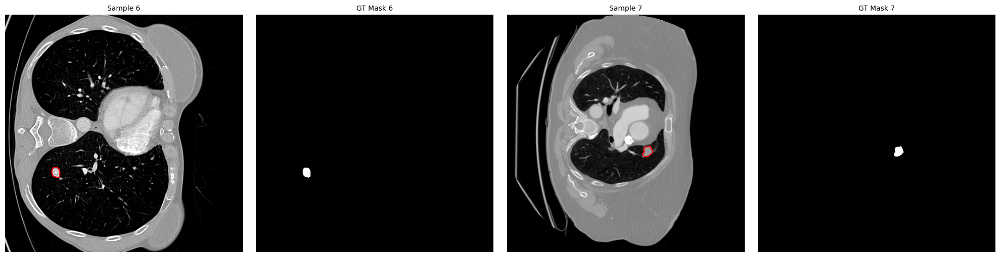

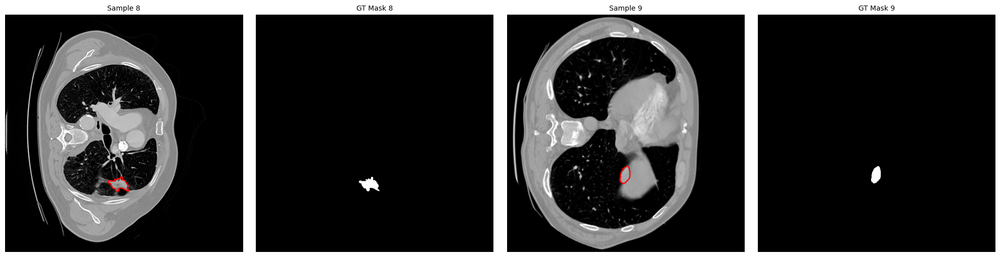

...

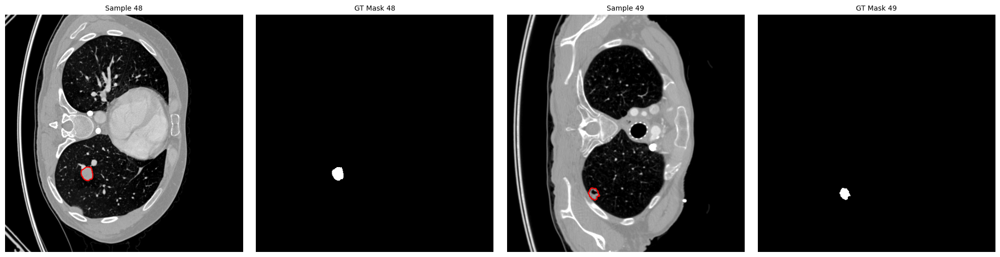

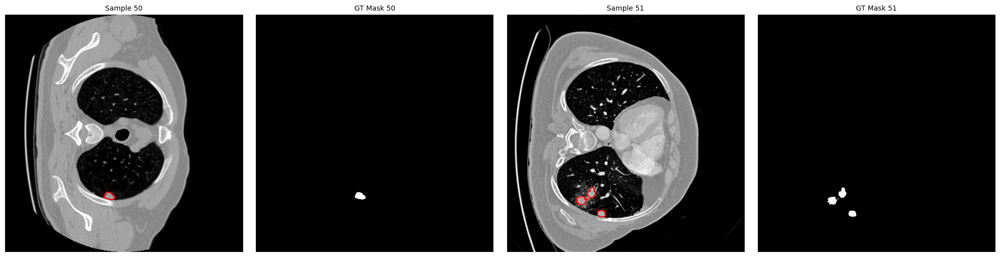

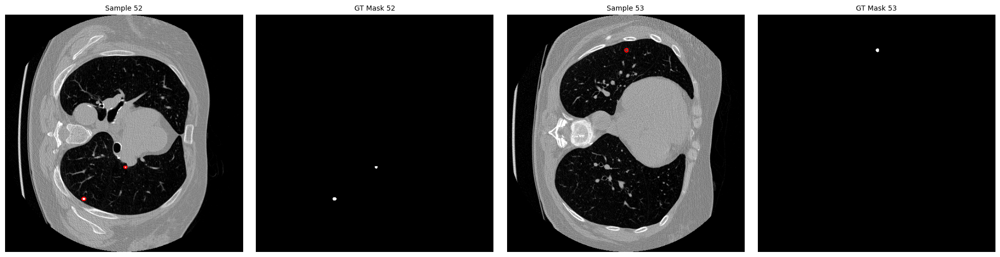

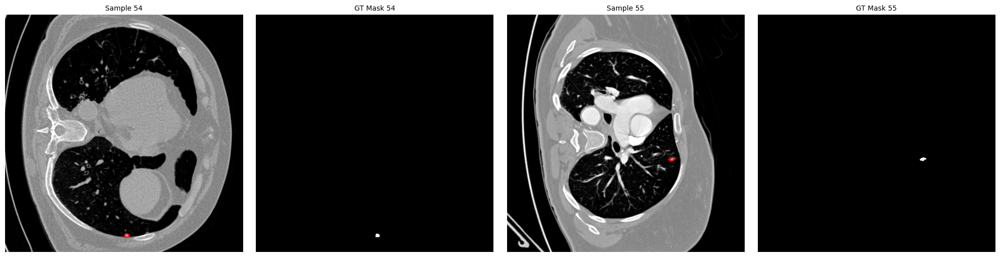

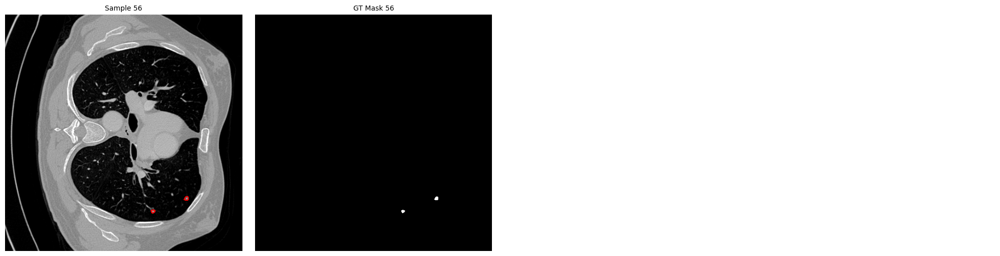

In [4]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_dataset_with_gt_contours(dataset):
    """
    Visualizes the entire dataset showing each sample's image with its ground truth mask as a contour,
    followed by the ground truth mask alone in separate figures. Each figure will contain
    four plots (two images and their GT masks) for two samples.

    Parameters:
    - dataset: The dataset object with a `get_sample` method to access samples.
    """
    n_samples = len(dataset)  # Assuming the dataset object supports len()

    for i in range(0, n_samples, 2):  # Process two samples at a time
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))  # Create a new figure for each pair of samples
        
        for j in range(2):
            index = i + j
            if index < n_samples:  # Check to prevent index out of range
                sample = dataset.get_sample(index)
                image = sample.image[:,:,0]
                gt_mask = sample.gt_mask
                
                # Display input image with GT mask as contour
                col = j * 2  # Column index for image and its GT mask
                axs[col].imshow(image, cmap='gray')  # Show the input image
                axs[col].contour(gt_mask, colors='r', levels=[0.5], linestyles='solid', linewidths=1.5)
                axs[col].set_title(f'Sample {index}', fontsize=10)
                axs[col].axis('off')
                
                # Display GT mask alone
                axs[col + 1].imshow(gt_mask, cmap='gray')  # Show the GT mask
                axs[col + 1].set_title(f'GT Mask {index}', fontsize=10)
                axs[col + 1].axis('off')
                
            else:  # Hide unused subplots if the total number of samples is odd
                axs[j * 2].axis('off')
                axs[j * 2 + 1].axis('off')
                
        plt.tight_layout()
        plt.show()

# Example usage:
visualize_dataset_with_gt_contours(dataset)
